# 各種ライブラリのインポート

In [1]:
import requests
from PIL import Image

# サブスクリプションキーの設定

In [2]:
subscription_key = "ef721e19afb345b19037541b7cc34a68"
assert subscription_key

# APIのエンドポイントの設定

In [3]:
face_api_url = "https://20210528akialice1018.cognitiveservices.azure.com/face/v1.0/detect"

# 画像を読み込む

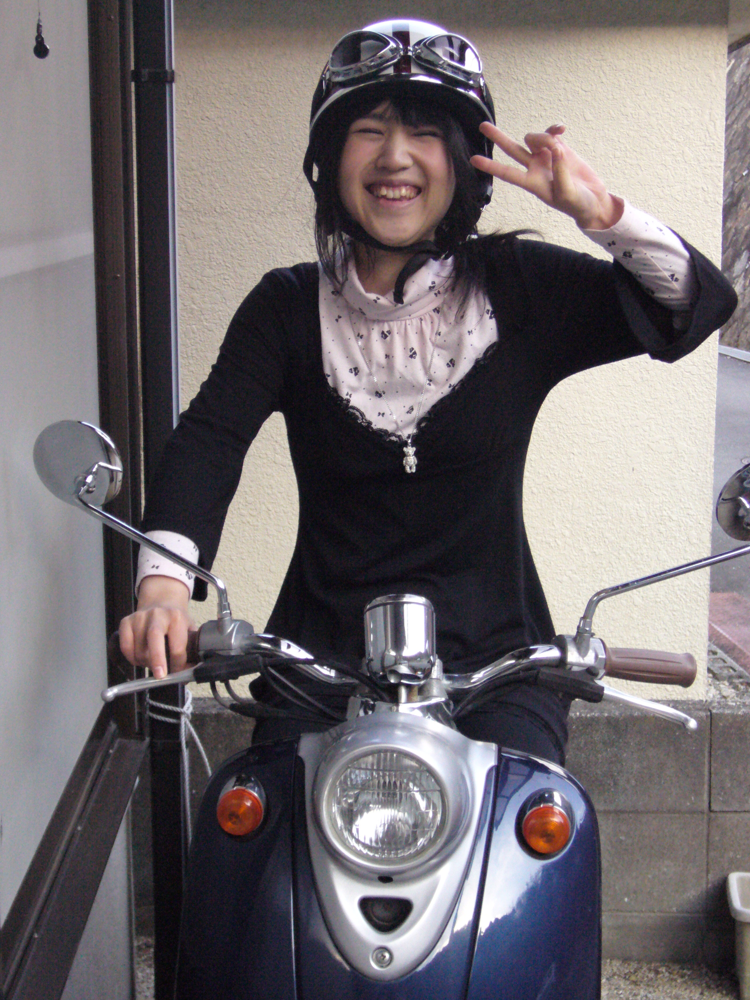

In [4]:
img = Image.open("sample01.jpg")
img

# 画像をバイナリデータに変換する

In [5]:
with open("sample01.jpg", "rb") as f:
    binary_img = f.read()

# 画像のパラメータを取り、結果をresult変数に格納

In [6]:
headers = {
    "Content-Type": "application/octet-stream",
    "Ocp-Apim-Subscription-Key": subscription_key
}

params = {
    "returnFaceId": True,
    "returnFaceAttributes" : "age, gender, headPose, smile, facialHair, glasses, emotion, hair, makeup, occlusion, accessories, blur, exposure, noise"
}

res = requests.post(face_api_url, params=params, 
                    headers=headers, data=binary_img)

In [7]:
res

<Response [200]>

In [8]:
result = res.json()
result

[{'faceId': '7f103a4a-2189-4311-b6d7-de72609dfc40',
  'faceRectangle': {'top': 271, 'left': 935, 'width': 360, 'height': 360},
  'faceAttributes': {'smile': 1.0,
   'headPose': {'pitch': 9.0, 'roll': 1.1, 'yaw': -2.0},
   'gender': 'female',
   'age': 20.0,
   'facialHair': {'moustache': 0.0, 'beard': 0.0, 'sideburns': 0.0},
   'glasses': 'NoGlasses',
   'emotion': {'anger': 0.0,
    'contempt': 0.0,
    'disgust': 0.0,
    'fear': 0.0,
    'happiness': 1.0,
    'neutral': 0.0,
    'sadness': 0.0,
    'surprise': 0.0},
   'blur': {'blurLevel': 'low', 'value': 0.05},
   'exposure': {'exposureLevel': 'goodExposure', 'value': 0.36},
   'noise': {'noiseLevel': 'low', 'value': 0.03},
   'makeup': {'eyeMakeup': False, 'lipMakeup': True},
   'accessories': [{'type': 'headwear', 'confidence': 1.0}],
   'occlusion': {'foreheadOccluded': True,
    'eyeOccluded': False,
    'mouthOccluded': False},
   'hair': {'bald': 0.0, 'invisible': True, 'hairColor': []}}}]

# 顔を認識する矩形を描画する

In [9]:
rect = result[0]["faceRectangle"]
rect

{'top': 271, 'left': 935, 'width': 360, 'height': 360}

In [10]:
# 矩形を描画する為のモジュールのインポート
from PIL import ImageDraw

In [11]:
draw = ImageDraw.Draw(img)

In [12]:
#draw.line([(0,50), (200,50), (0,150), (200,150)], fill="red", width=5)
#img

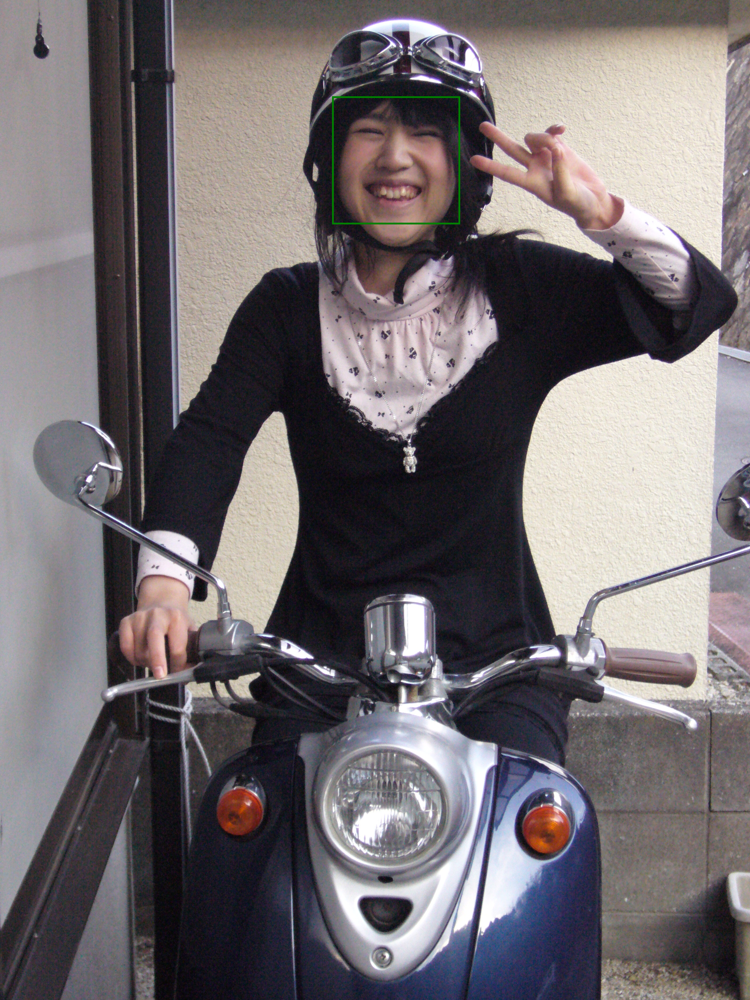

In [13]:
draw.rectangle([(rect["left"], rect["top"]), (rect["left"]+rect["width"], rect["top"]+rect["height"])], fill=None, outline="green", width=5)
img

# 必要なコードのまとめ

In [14]:
# 各種ライブラリのインポート
import requests
from PIL import Image
from PIL import ImageDraw
from PIL import ImageFont
import io

# サブスクリプションキーの設定
subscription_key = "ef721e19afb345b19037541b7cc34a68"
assert subscription_key
# APIのエンドポイントの設定
face_api_url = "https://20210528akialice1018.cognitiveservices.azure.com/face/v1.0/detect"

# 画像の読み込み
img = Image.open("sample02.jpg")
# 画像をバイナリデータに変換する
with io.BytesIO() as output:
    img.save(output, format="JPEG")
    binary_img = output.getvalue() #バイナリ取得
        
# APIを叩き、画像のパラメータを取徳後、結果をresult変数に格納
headers = {
    "Content-Type": "application/octet-stream",
    "Ocp-Apim-Subscription-Key": subscription_key
}

params = {
    "returnFaceId": True,
    "returnFaceAttributes" : "age, gender, headPose, smile, facialHair, glasses, emotion, hair, makeup, occlusion, accessories, blur, exposure, noise"
}

res = requests.post(face_api_url, params=params, 
                    headers=headers, data=binary_img)
results = res.json()

# 画像の顔部分の座標を取得
for result in results:
    rect = result["faceRectangle"]    
    # 認識した顔に矩形を描画
    draw = ImageDraw.Draw(img)
    draw.rectangle([(rect["left"], rect["top"]), (rect["left"]+rect["width"], rect["top"]+rect["height"])], fill=None, outline="green", width=5)
    # 性別・年齢描画の座標設定
    font_size = 80
    font_name = "C:\Windows\Fonts\meiryo.ttc"
    draw_x = rect['left']-10
    draw_y = rect['top']-100
    text = result['faceAttributes']['gender']+'/'+str(result['faceAttributes']['age'])
    font = ImageFont.truetype(font_name, font_size)　
    draw.text((draw_x, draw_y), text,font=font, fill='red')
img

SyntaxError: invalid character in identifier (<ipython-input-14-fa9dbc30a984>, line 48)